In [1]:
import os
import warnings
import pandas as pd
from socceraction.data.statsbomb import StatsBombLoader
import socceraction.spadl as spadl
pd.set_option('display.max_columns', None)
warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)
warnings.filterwarnings(action="ignore", message="credentials were not supplied. open data access only")

In [2]:
SBL = StatsBombLoader()

In [3]:
# 2022 WorlcCupの試合情報を取得
df_games = SBL.games(competition_id=43, season_id=106).set_index("game_id")

In [5]:
df_games.head()

,season_id,competition_id,competition_stage,game_day,game_date,home_team_id,away_team_id,home_score,away_score,venue,referee
game_id,,,,,,,,,,,
3857256,106,43,Group Stage,3,2022-12-02 21:00:00,786,773,2,3,Stadium 974,Fernando Andrés Rapallini
3869151,106,43,Round of 16,4,2022-12-03 21:00:00,779,792,2,1,Ahmad bin Ali Stadium,Szymon Marciniak
3857257,106,43,Group Stage,3,2022-11-30 17:00:00,792,776,1,0,Al Janoub Stadium,Mustapha Ghorbal
3857258,106,43,Group Stage,1,2022-11-24 21:00:00,781,786,2,0,Lusail Stadium,Alireza Faghani
3857288,106,43,Group Stage,2,2022-11-26 12:00:00,777,792,0,1,Al Janoub Stadium,Daniel Siebert


In [23]:
game_obj = df_games.iloc[0,:]

game_id = game_obj.name

df_events = SBL.events(game_id=game_id)
df_players = SBL.players(game_id=game_id)

df_actions = spadl.statsbomb.convert_to_actions(df_events, home_team_id=game_obj['home_team_id'])

df_actions = (
  spadl
  .add_names(df_actions)  # add actiontype and result names
  .merge(SBL.teams(game_id=game_id), how='left')  # add team names
  .merge(SBL.players(game_id=game_id), how='left')  # add player names
)

print(df_actions.shape)
df_actions.head()

(1880, 25)


,game_id,original_event_id,period_id,time_seconds,team_id,player_id,start_x,start_y,end_x,end_y,type_id,result_id,bodypart_id,action_id,type_name,result_name,bodypart_name,team_name,player_name,nickname,jersey_number,is_starter,starting_position_id,starting_position_name,minutes_played
0,3857256,4acb4fd2-f46a-4d73-993c-e06597873924,1,0.0,773,5545.0,52.058824,33.655696,67.852941,36.754430,0,1,5,0,pass,success,foot_right,Switzerland,Breel-Donald Embolo,Breel Embolo,7,True,23,Center Forward,97
1,3857256,0e5c867f-8c40-4754-bc81-014c8cf88b8d,1,1.0,773,6983.0,67.852941,36.754430,70.852941,38.303797,21,1,0,1,dribble,success,foot,Switzerland,Remo Freuler,None,8,True,9,Right Defensive Midfield,102
2,3857256,f21fda3d-cb2c-4608-af2d-201d1ad8101c,1,3.0,773,6983.0,70.852941,38.303797,68.558824,61.286076,0,1,5,2,pass,success,foot_right,Switzerland,Remo Freuler,None,8,True,9,Right Defensive Midfield,102
3,3857256,a54c6781-c843-40bb-9973-cdef963cb218,1,5.0,773,7796.0,68.558824,61.286076,68.558824,61.286076,21,1,0,3,dribble,success,foot,Switzerland,Silvan Widmer,None,3,True,2,Right Back,102
4,3857256,57654ce3-e311-49c4-9ba7-4fab2ec66f71,1,6.0,773,7796.0,68.558824,61.286076,85.500000,52.850633,0,1,5,4,pass,success,foot_right,Switzerland,Silvan Widmer,None,3,True,2,Right Back,102


In [24]:
df_all_games_passes = None

for index, game_obj in df_games.iterrows():

    game_id = game_obj.name

    df_events = SBL.events(game_id=game_id)
    df_players = SBL.players(game_id=game_id)

    df_actions = spadl.statsbomb.convert_to_actions(df_events, home_team_id=game_obj['home_team_id'])

    df_actions = (
      spadl
      .add_names(df_actions)  # add actiontype and result names
      .merge(SBL.teams(game_id=game_id), how='left')  # add team names
      .merge(SBL.players(game_id=game_id), how='left')  # add player names
    )
    
    df_passes = df_actions[(df_actions['type_name'] == 'pass')]
    
    if df_all_games_actions is None:
        df_all_games_passes = df_actions
    else:
        df_all_games_passes = pd.concat([df_all_games_passes, df_actions], axis=0, ignore_index=True)
        
df_all_games_passes.shape

(138738, 25)

In [25]:
138738/64

2167.78125

チームごとの全試合の（3-7試合）をすべてpitchにプロットしようと思ったがやめよう。
試合ごとにする

In [27]:
# チームのidと国名を紐づけたdfを作成
team_dic = {}
for index, game in df_games.iterrows():
    df_game_team = SBL.teams(game.name)
    team_dic[df_game_team.iloc[0,0]] = df_game_team.iloc[0,1]
    team_dic[df_game_team.iloc[1,0]] = df_game_team.iloc[1,1]
df_team = pd.DataFrame.from_dict(team_dic, orient='index')
df_team

,0
773,Switzerland
786,Serbia
779,Argentina
792,Australia
776,Denmark
781,Brazil
777,Tunisia
787,Senegal
3565,Ecuador
941,Netherlands


In [35]:
df_team.loc[797]

0    Iran
Name: 797, dtype: object

In [42]:
import matplotsoccer
import matplotlib.pyplot as plt

----------------------------------------------
home
Serbia


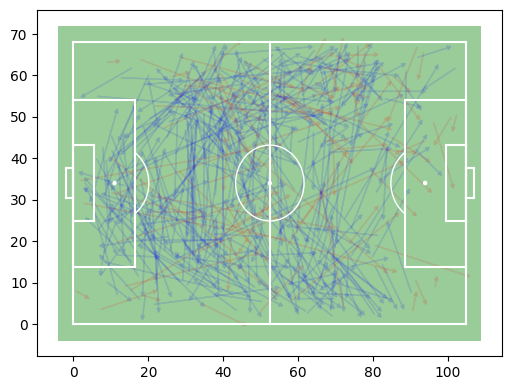

away
Switzerland


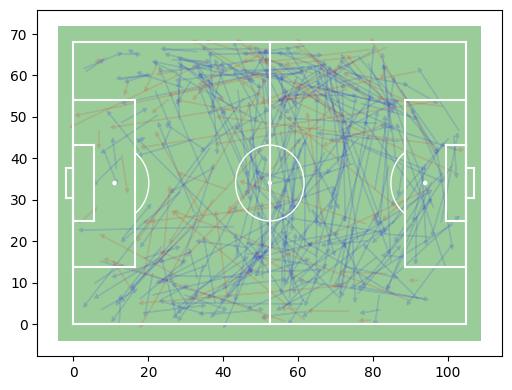

----------------------------------------------
home
Argentina


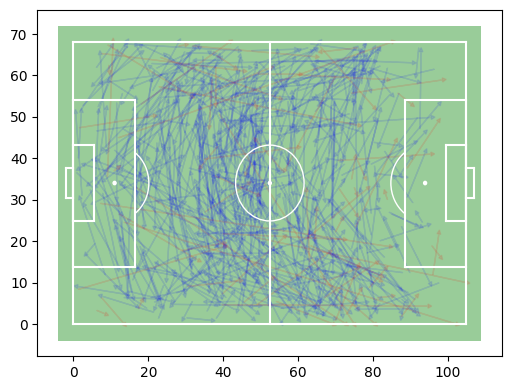

away
Australia


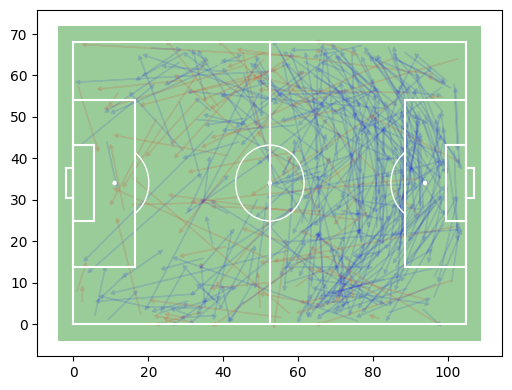

----------------------------------------------
home
Australia


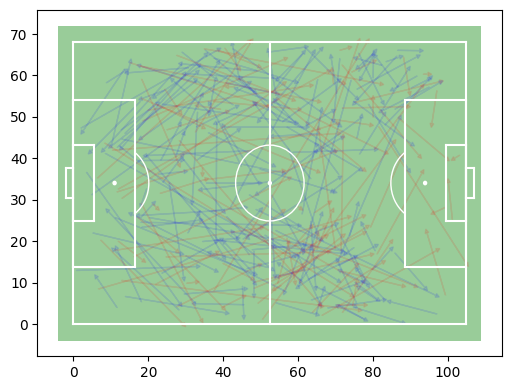

away
Denmark


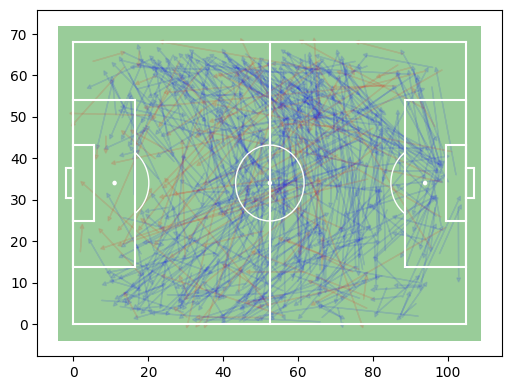

----------------------------------------------
home
Brazil


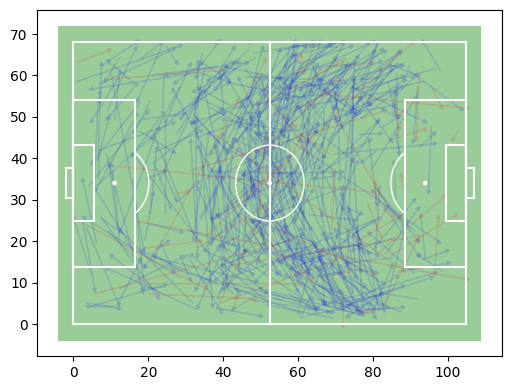

away
Serbia


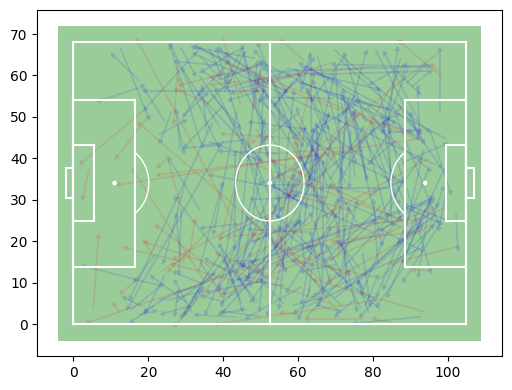

----------------------------------------------
home
Tunisia


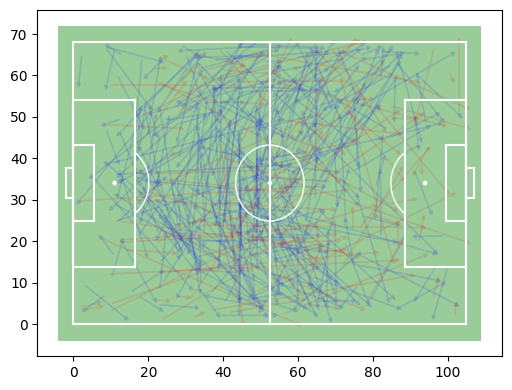

away
Australia


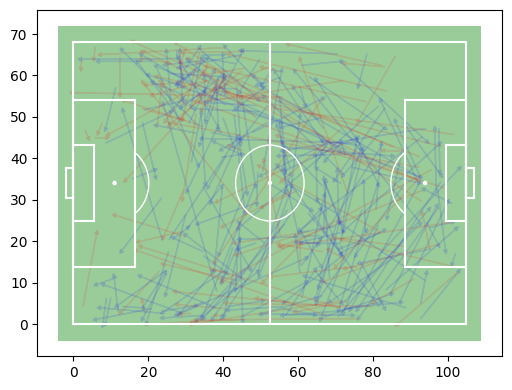

----------------------------------------------
home
Ecuador


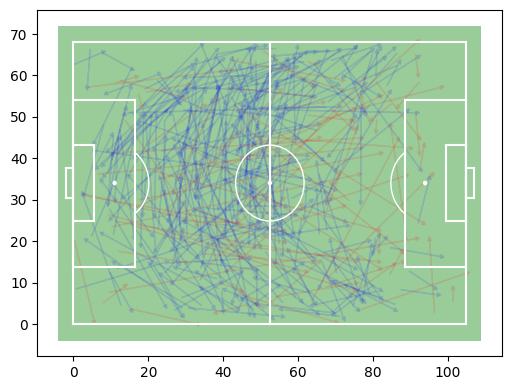

away
Senegal


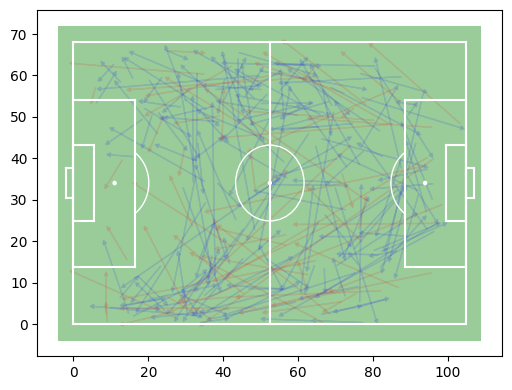

----------------------------------------------
home
Netherlands


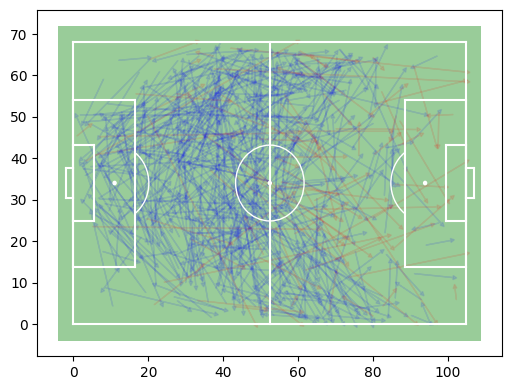

away
Argentina


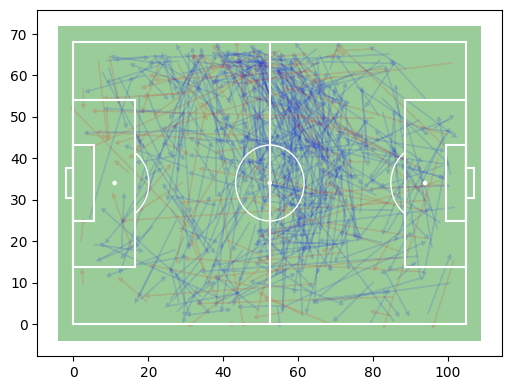

----------------------------------------------
home
Uruguay


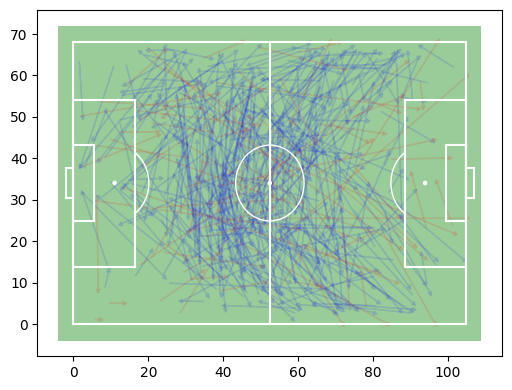

away
South Korea


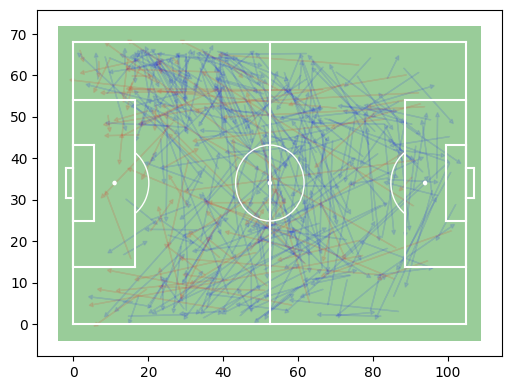

----------------------------------------------
home
Morocco


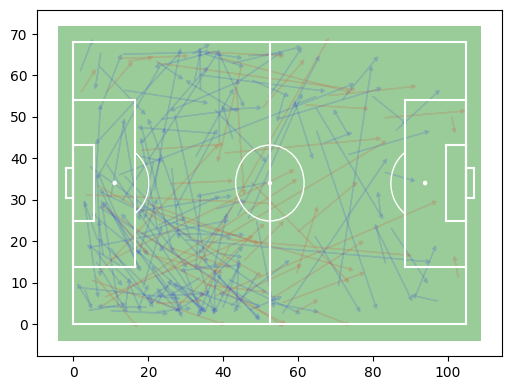

away
Portugal


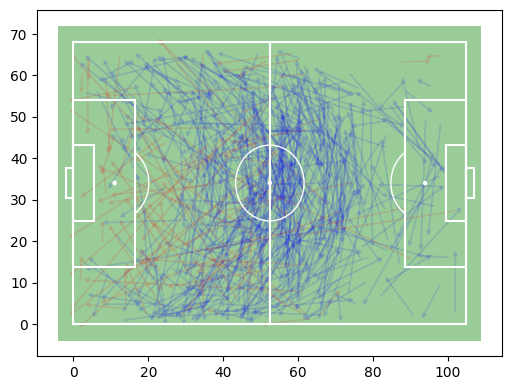

----------------------------------------------
home
Argentina


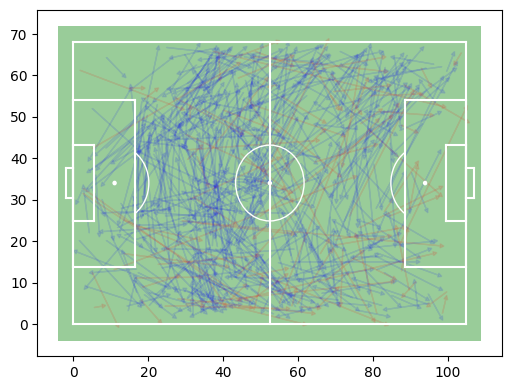

away
France


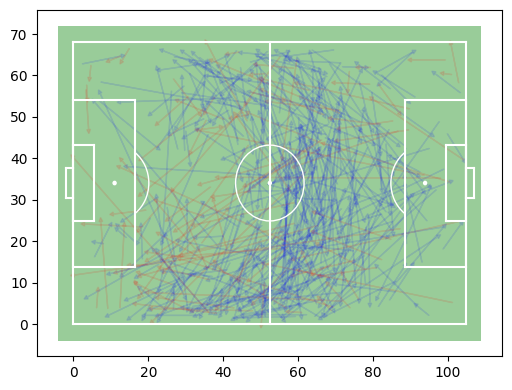

----------------------------------------------
home
Saudi Arabia


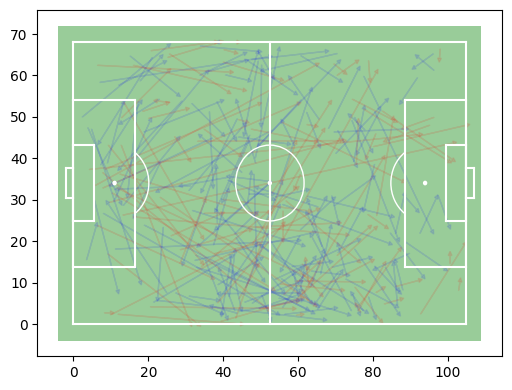

away
Mexico


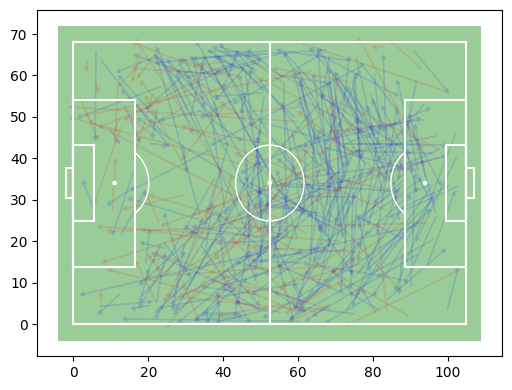

----------------------------------------------
home
Poland


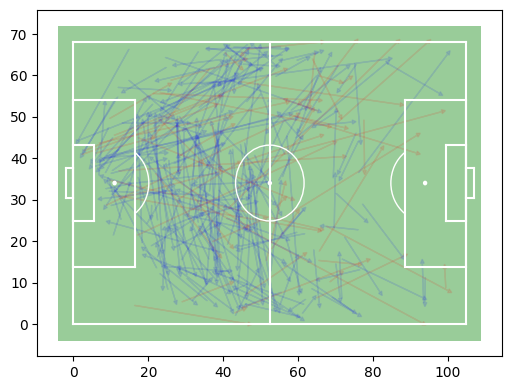

away
Argentina


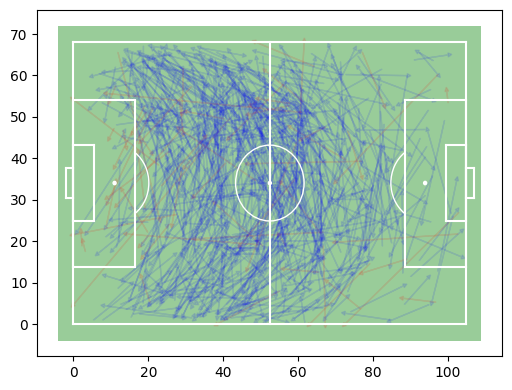

----------------------------------------------
home
France


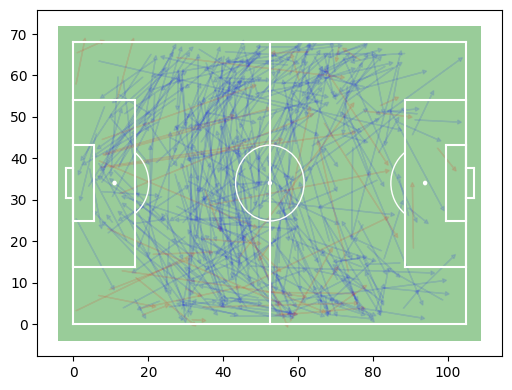

away
Denmark


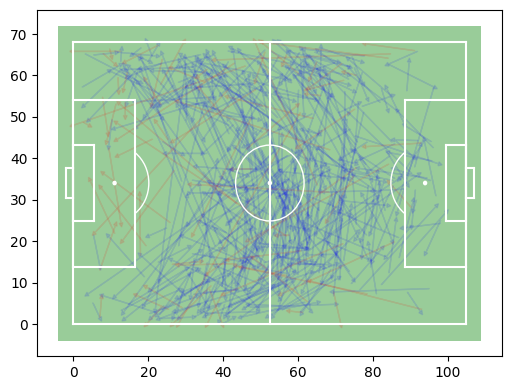

----------------------------------------------
home
Argentina


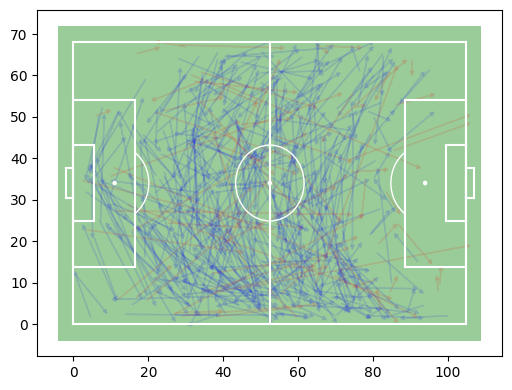

away
Mexico


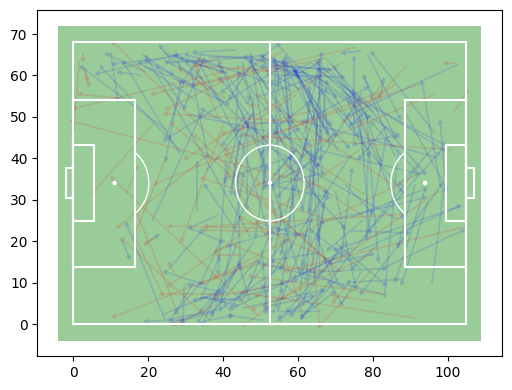

----------------------------------------------
home
Brazil


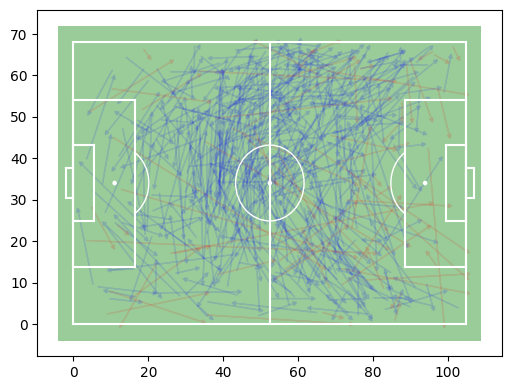

away
Switzerland


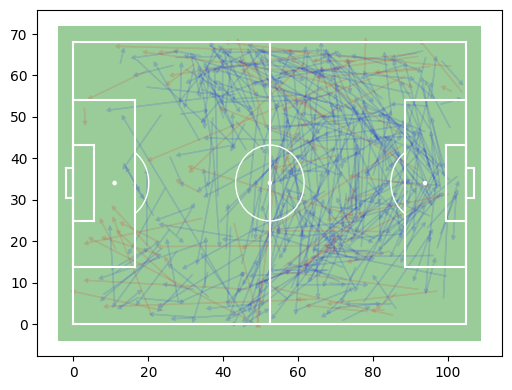

----------------------------------------------
home
Netherlands


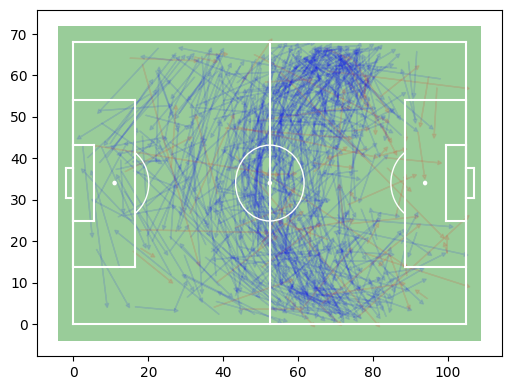

away
Qatar


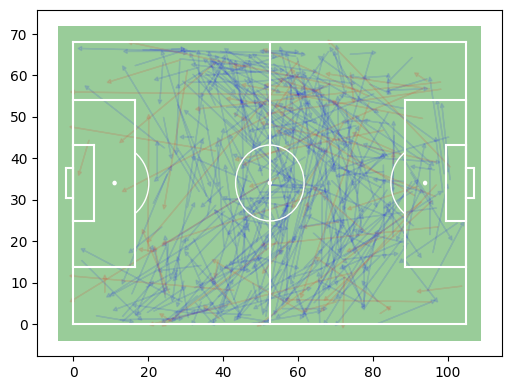

----------------------------------------------
home
Portugal


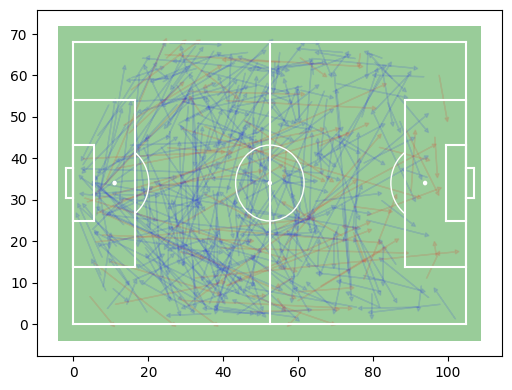

away
Switzerland


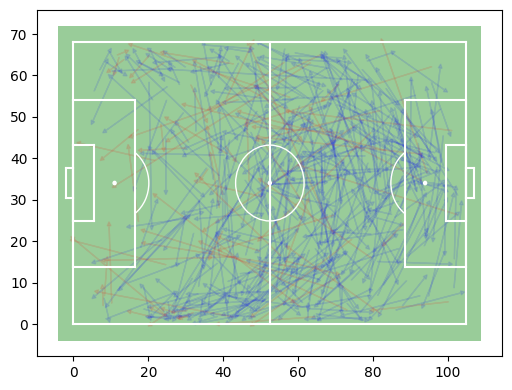

----------------------------------------------
home
England


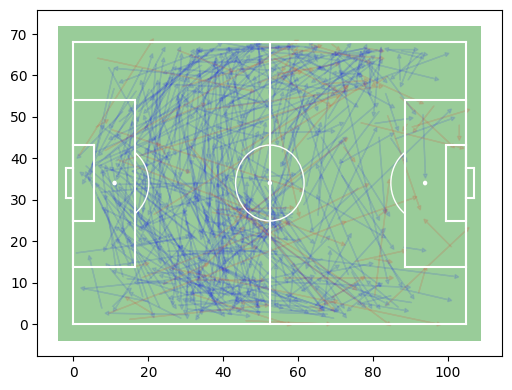

away
Senegal


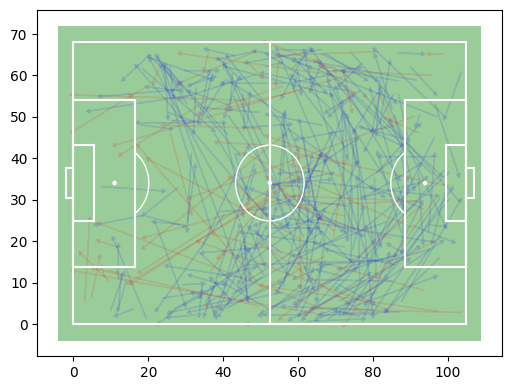

----------------------------------------------
home
Croatia


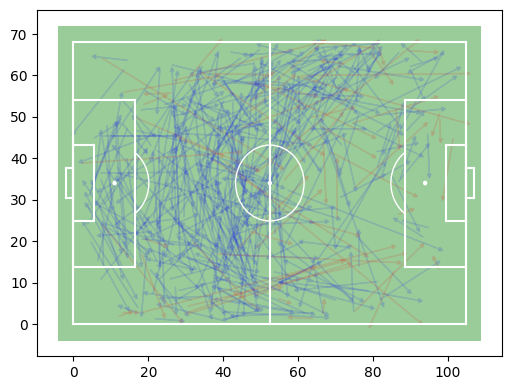

away
Morocco


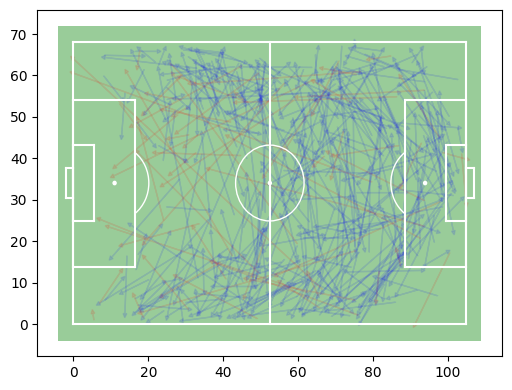

----------------------------------------------
home
Argentina


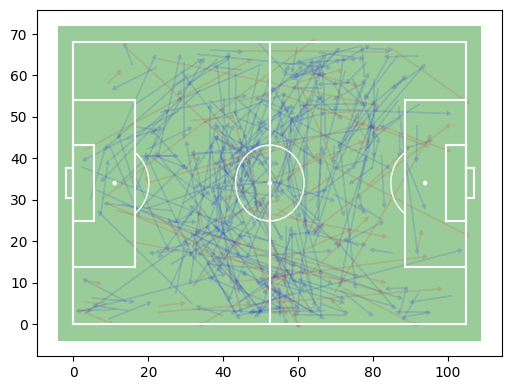

away
Croatia


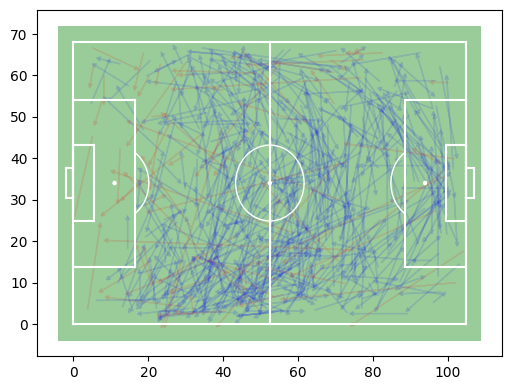

----------------------------------------------
home
England


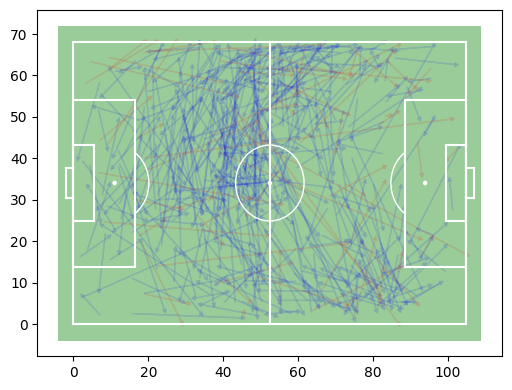

away
France


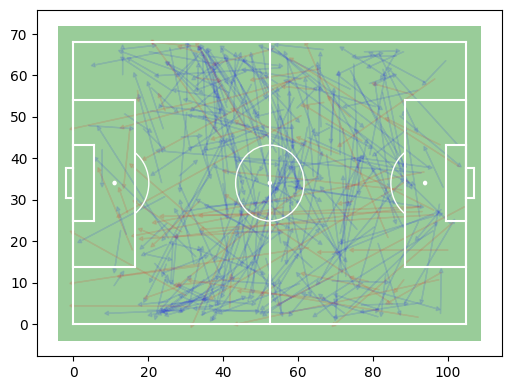

----------------------------------------------
home
France


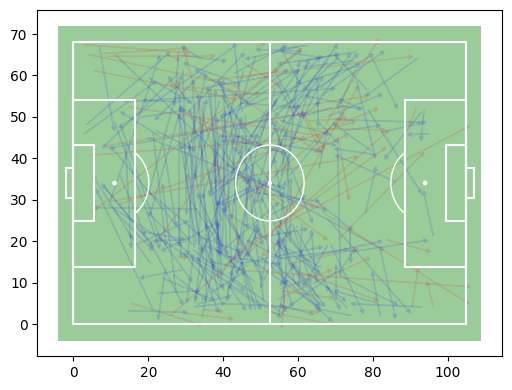

away
Morocco


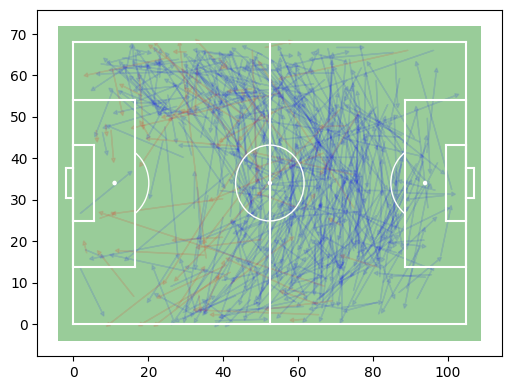

----------------------------------------------
home
Croatia


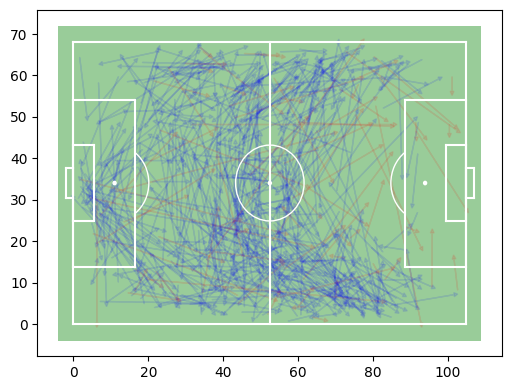

away
Brazil


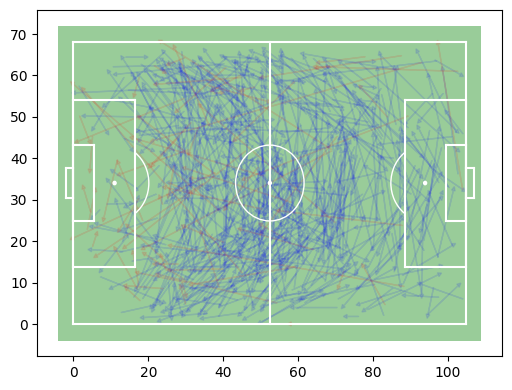

----------------------------------------------
home
Morocco


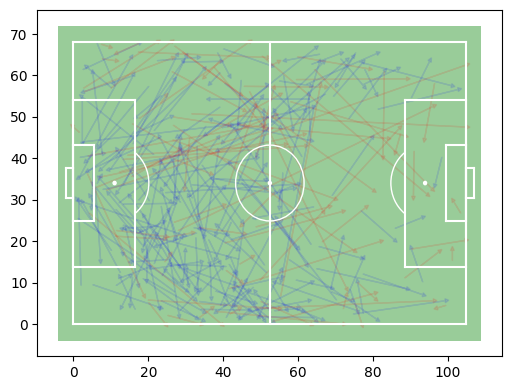

away
Spain


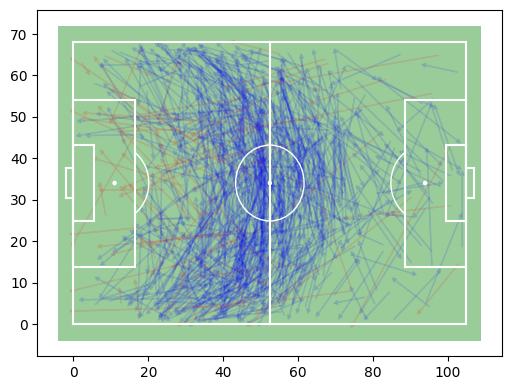

----------------------------------------------
home
Japan


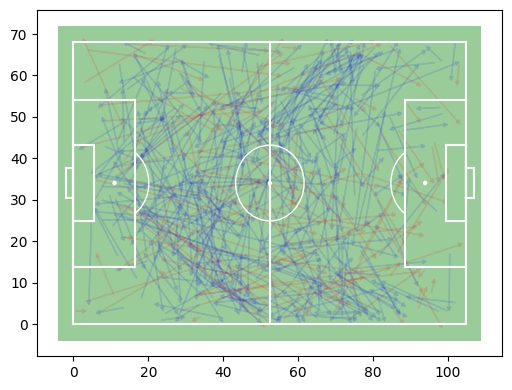

away
Croatia


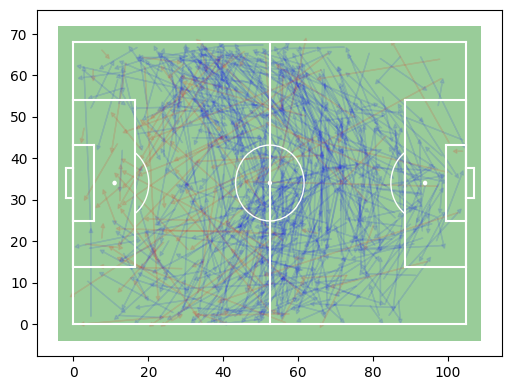

----------------------------------------------
home
Brazil


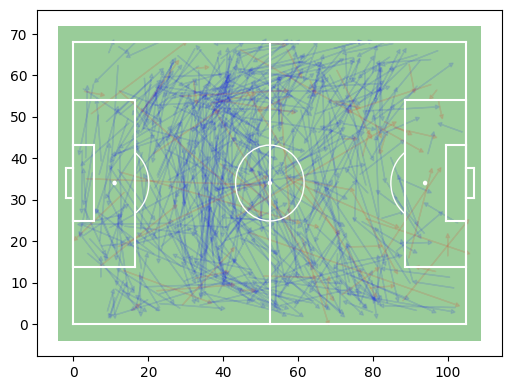

away
South Korea


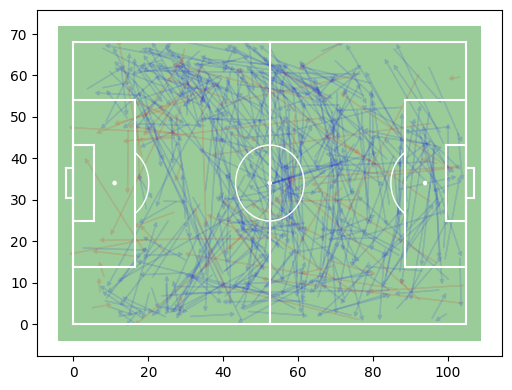

----------------------------------------------
home
France


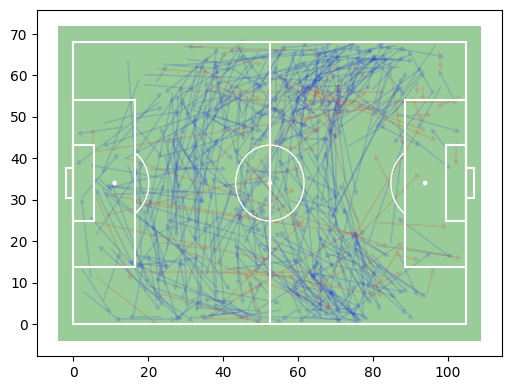

away
Poland


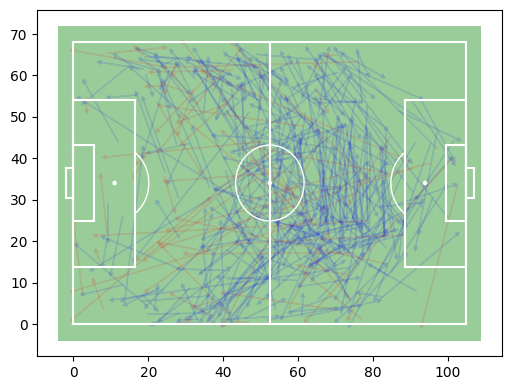

----------------------------------------------
home
Netherlands


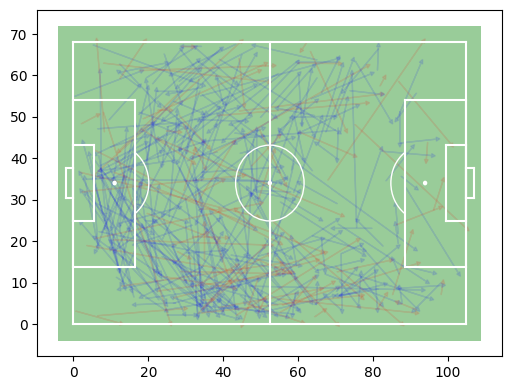

away
United States


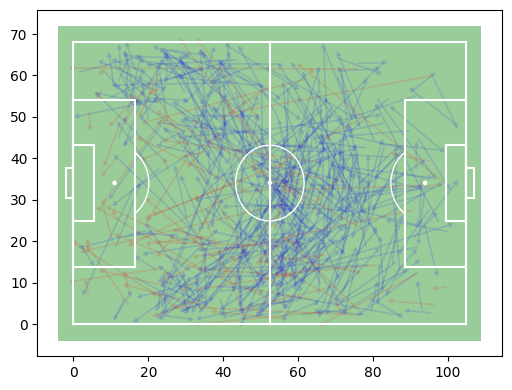

----------------------------------------------
home
Portugal


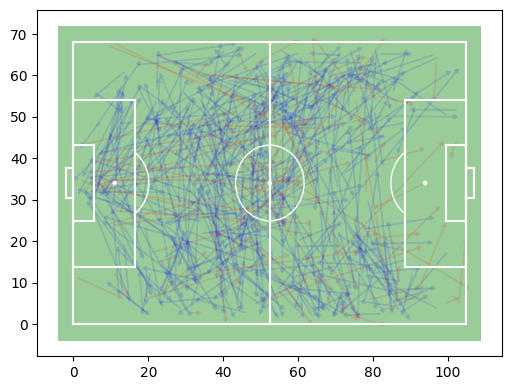

away
Uruguay


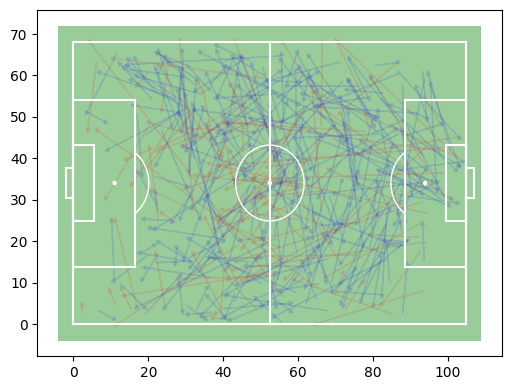

----------------------------------------------
home
Spain


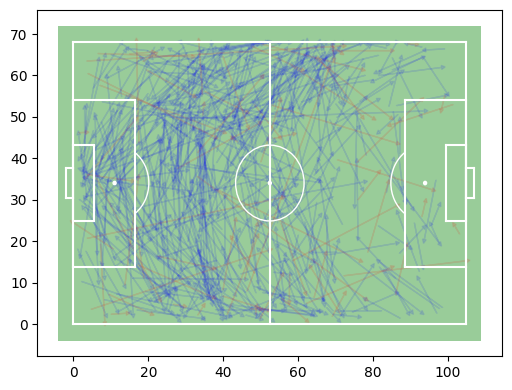

away
Germany


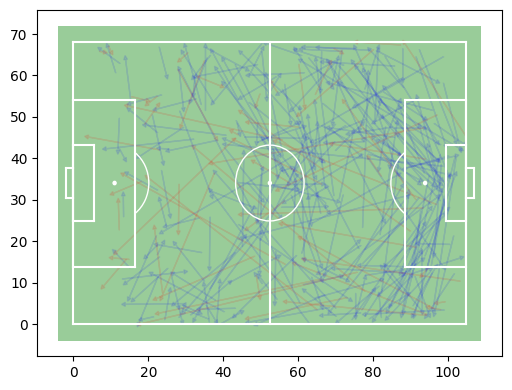

----------------------------------------------
home
Cameroon


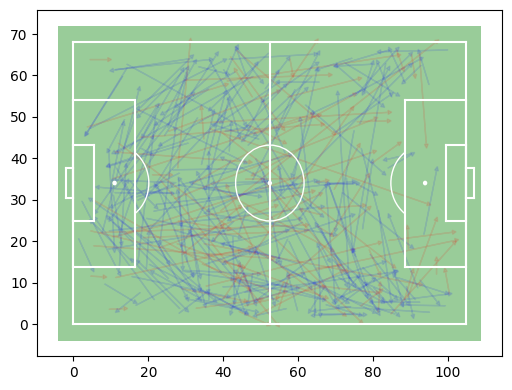

away
Serbia


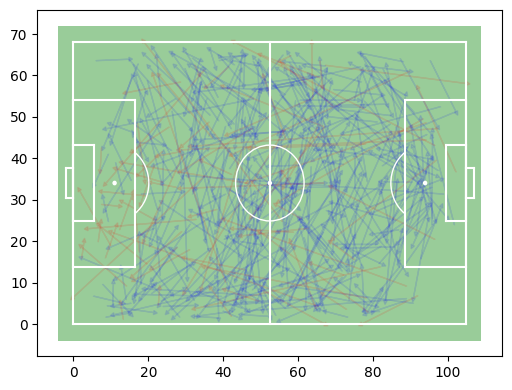

----------------------------------------------
home
Japan


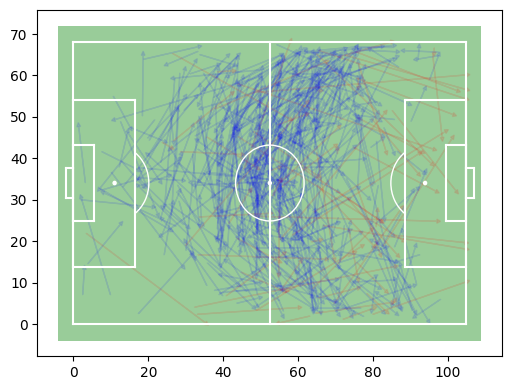

away
Costa Rica


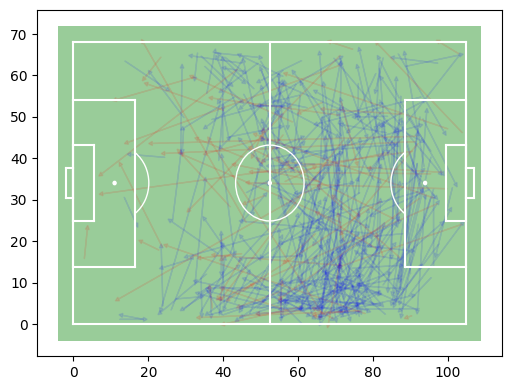

----------------------------------------------
home
Belgium


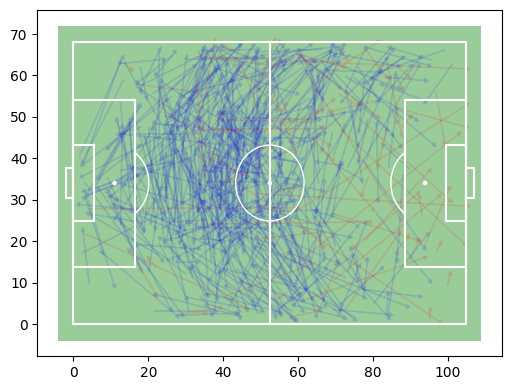

away
Morocco


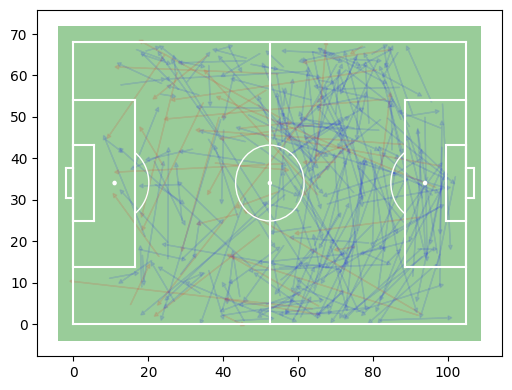

----------------------------------------------
home
Germany


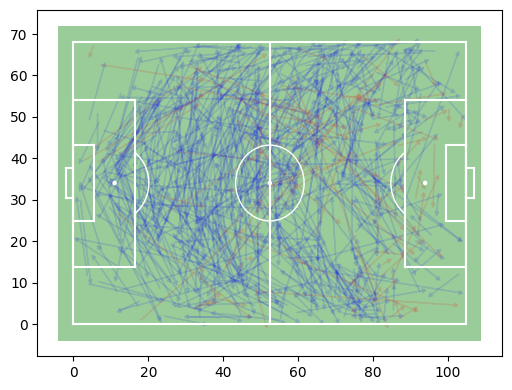

away
Japan


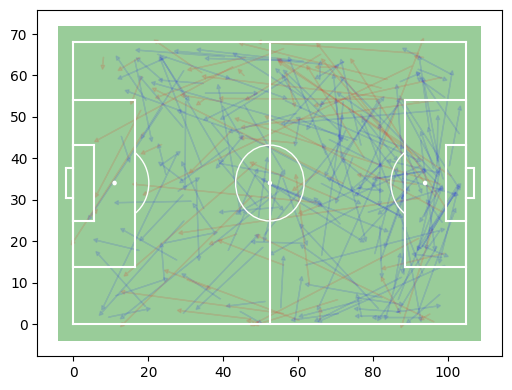

----------------------------------------------
home
United States


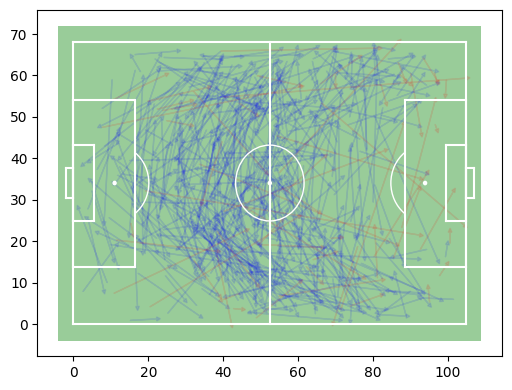

away
Wales


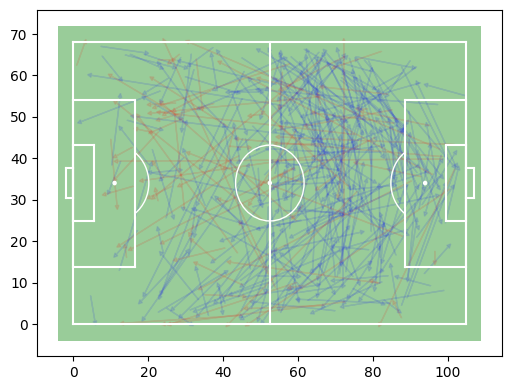

----------------------------------------------
home
Qatar


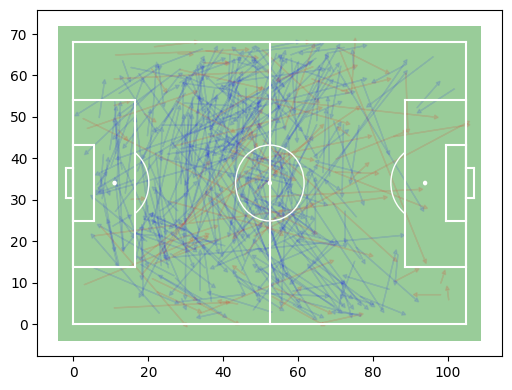

away
Ecuador


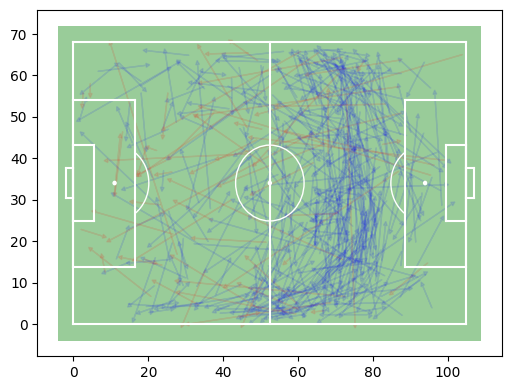

----------------------------------------------
home
Qatar


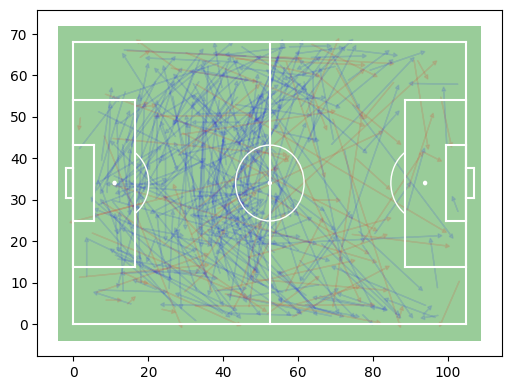

away
Senegal


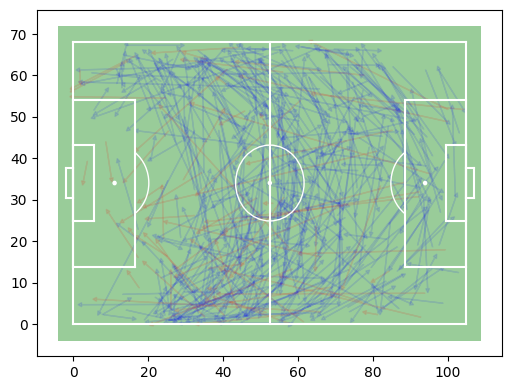

----------------------------------------------
home
Argentina


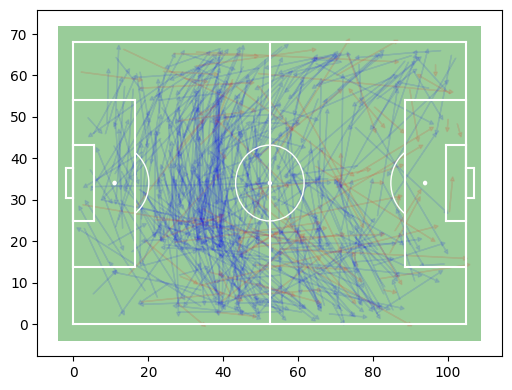

away
Saudi Arabia


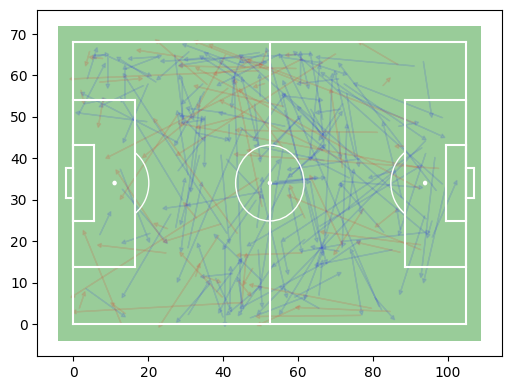

----------------------------------------------
home
South Korea


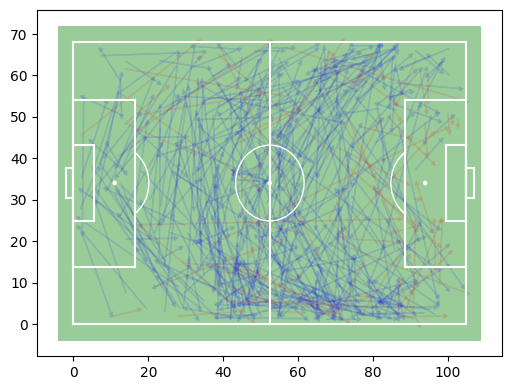

away
Ghana


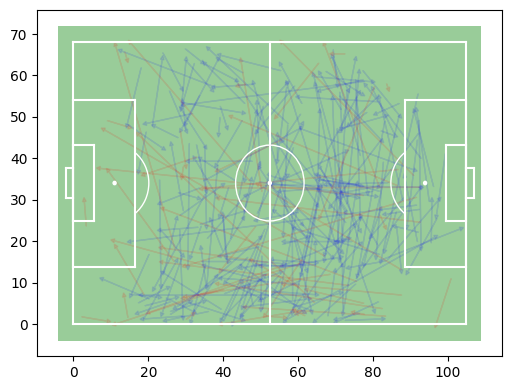

----------------------------------------------
home
Portugal


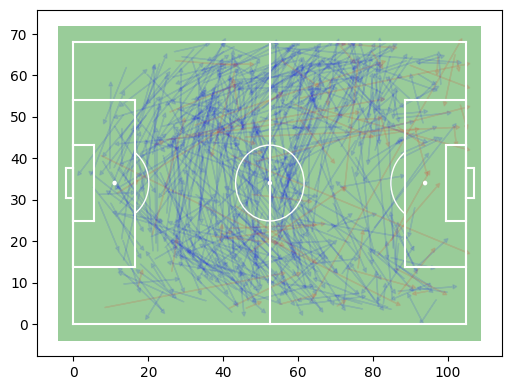

away
Ghana


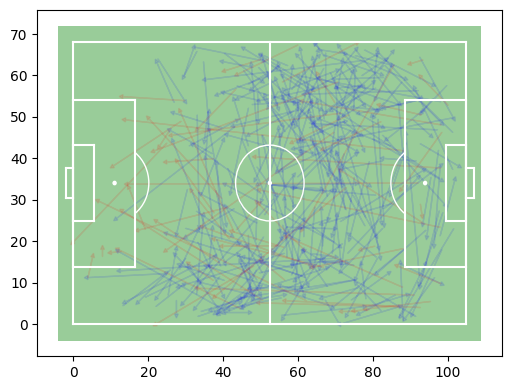

----------------------------------------------
home
Poland


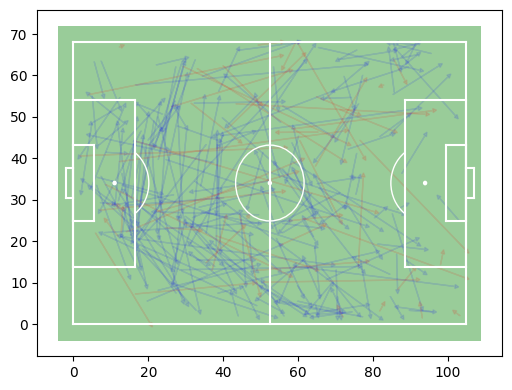

away
Saudi Arabia


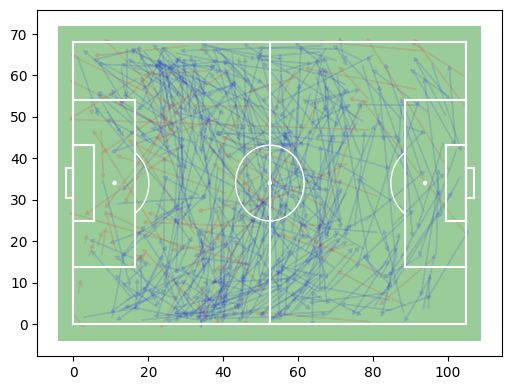

----------------------------------------------
home
Croatia


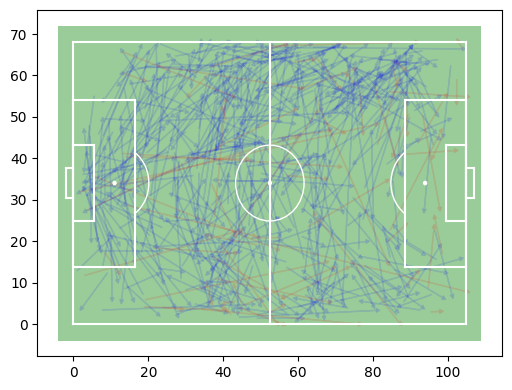

away
Belgium


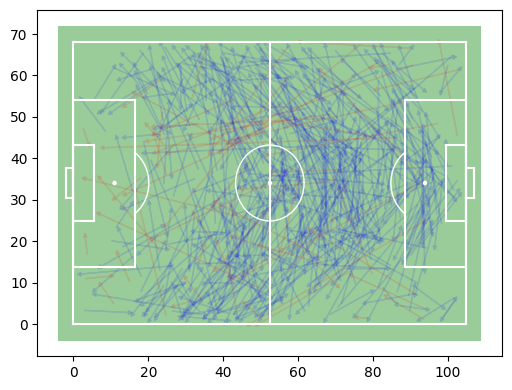

----------------------------------------------
home
Ghana


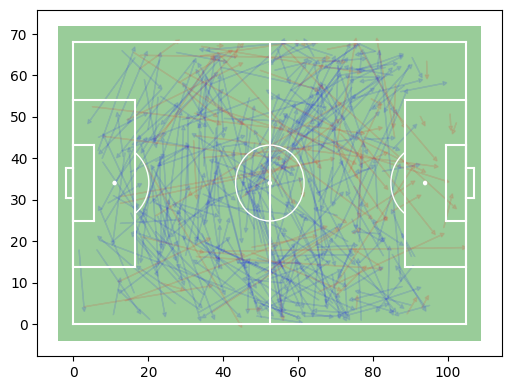

away
Uruguay


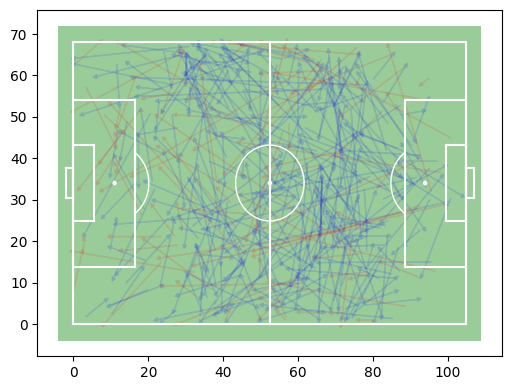

----------------------------------------------
home
Costa Rica


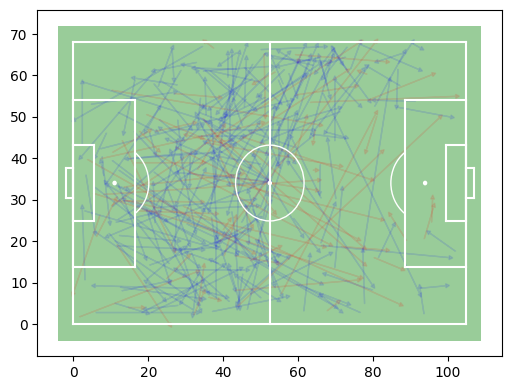

away
Germany


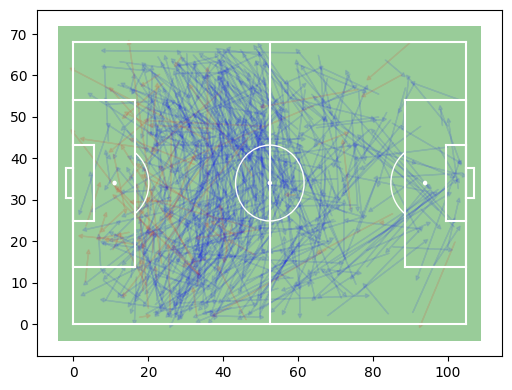

----------------------------------------------
home
Spain


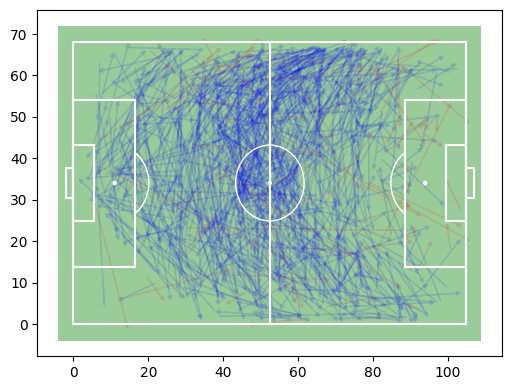

away
Costa Rica


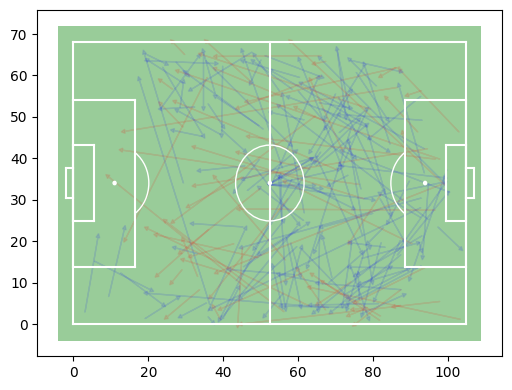

----------------------------------------------
home
Switzerland


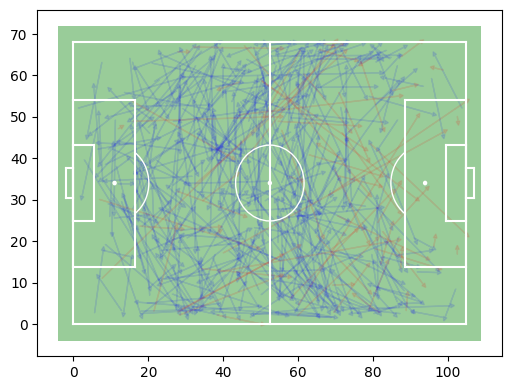

away
Cameroon


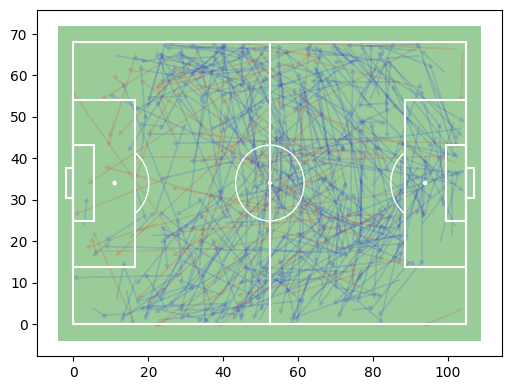

----------------------------------------------
home
Senegal


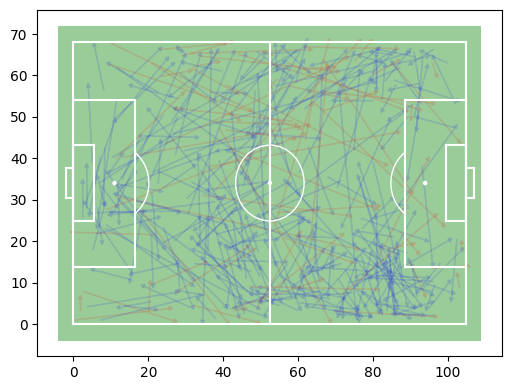

away
Netherlands


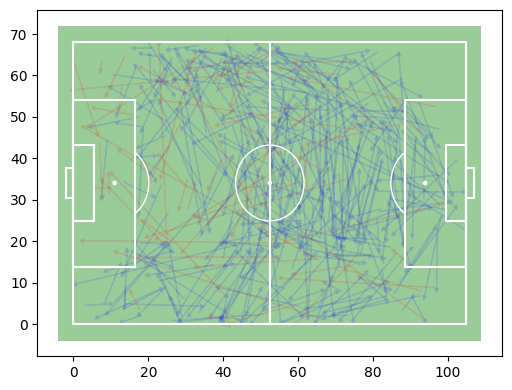

----------------------------------------------
home
Croatia


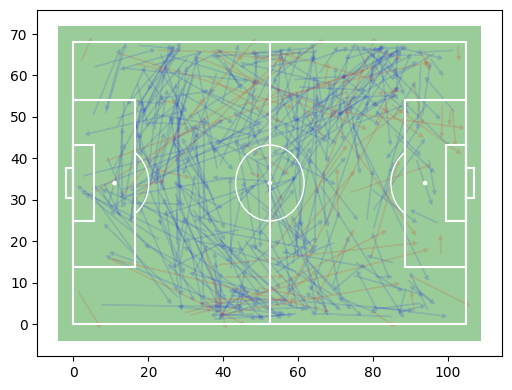

away
Canada


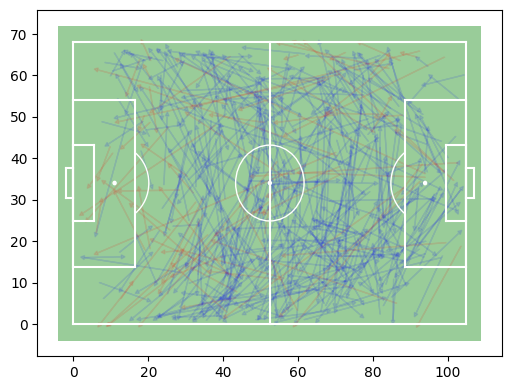

----------------------------------------------
home
Cameroon


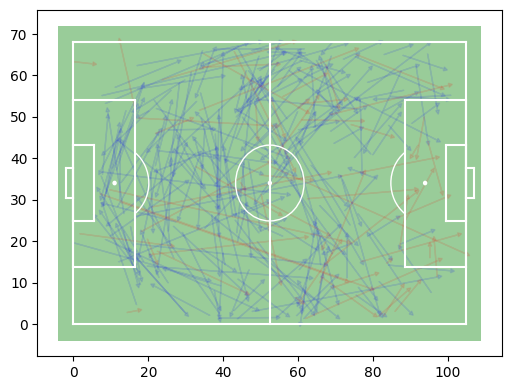

away
Brazil


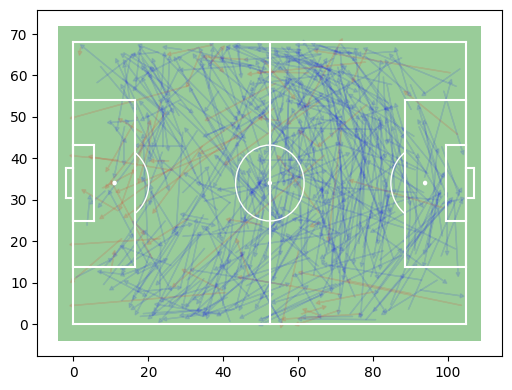

----------------------------------------------
home
France


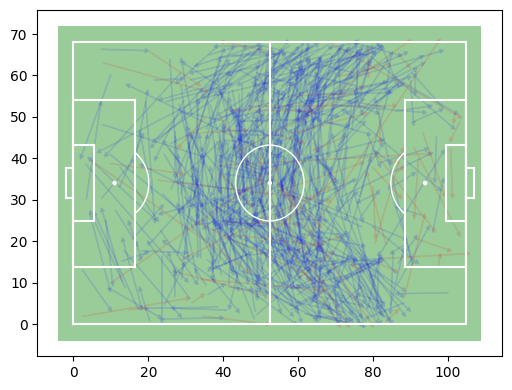

away
Australia


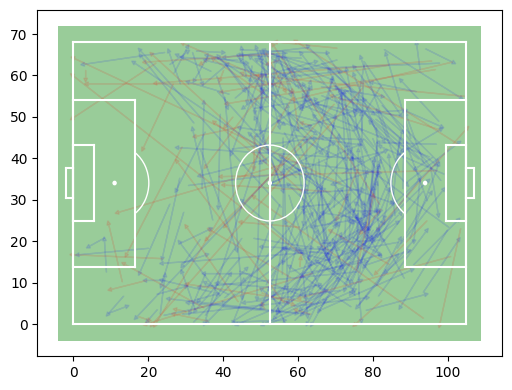

----------------------------------------------
home
Iran


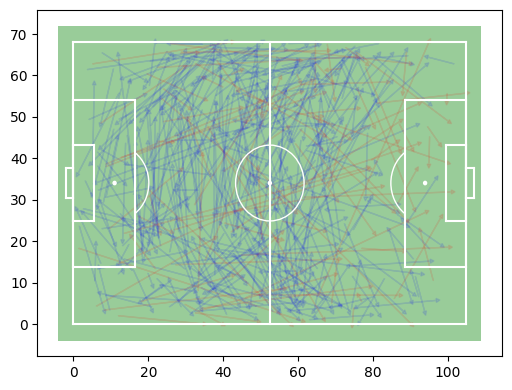

away
United States


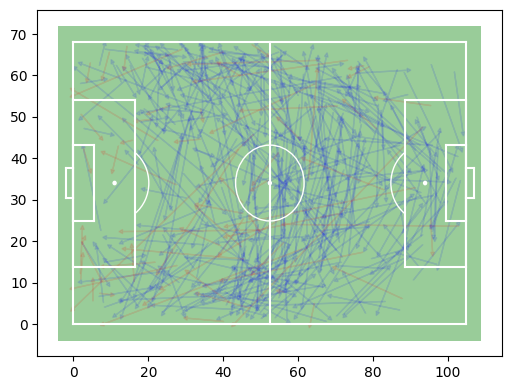

----------------------------------------------
home
Morocco


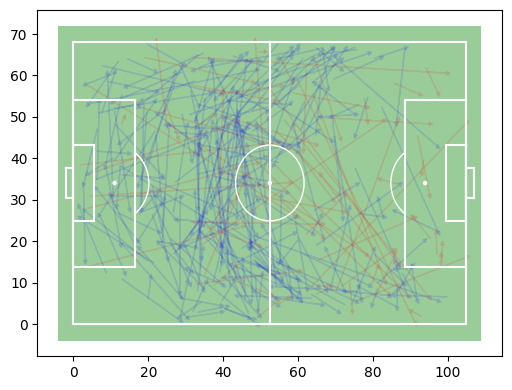

away
Croatia


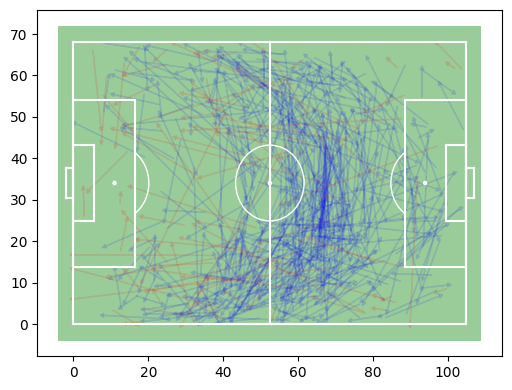

----------------------------------------------
home
Canada


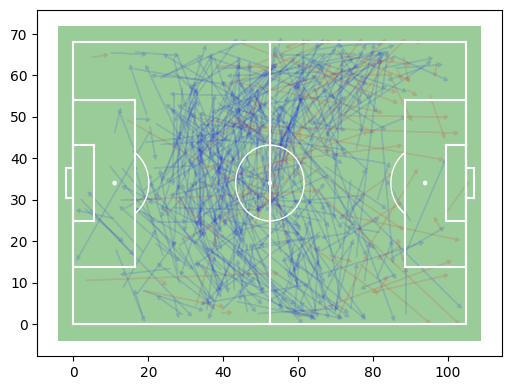

away
Morocco


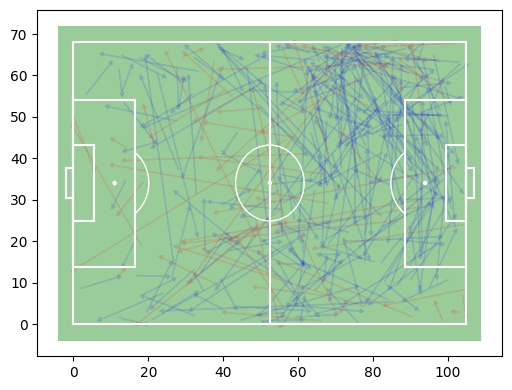

----------------------------------------------
home
Tunisia


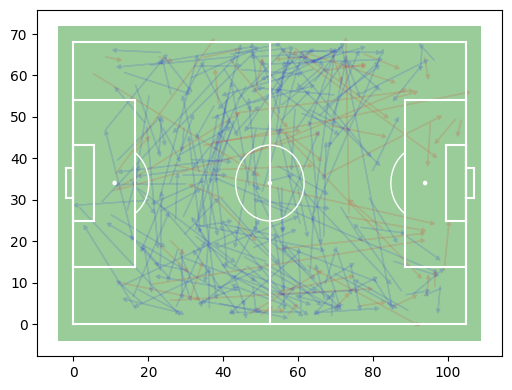

away
France


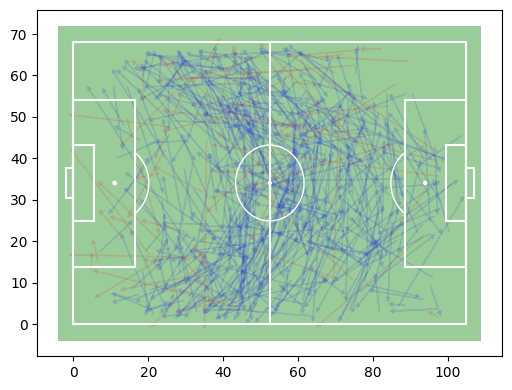

----------------------------------------------
home
Netherlands


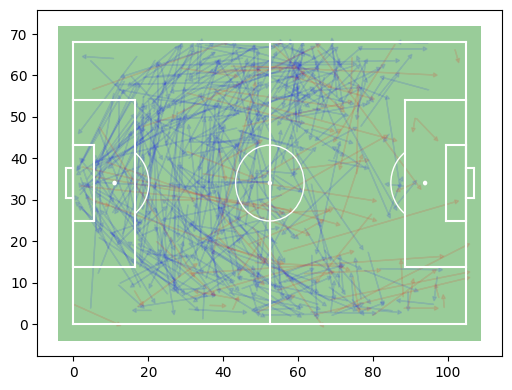

away
Ecuador


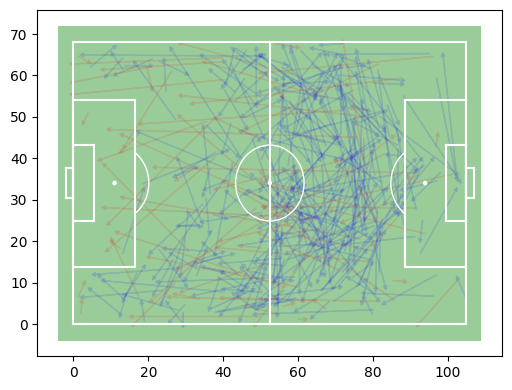

----------------------------------------------
home
Wales


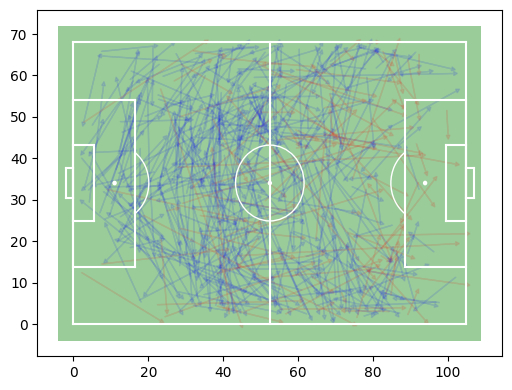

away
Iran


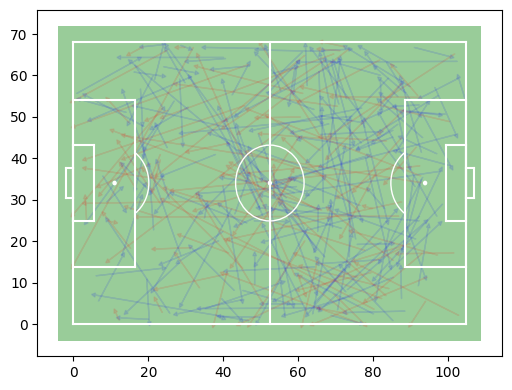

----------------------------------------------
home
England


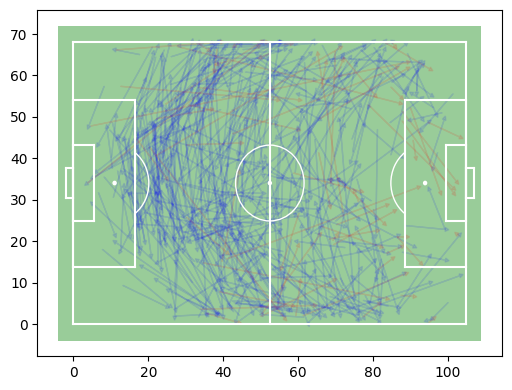

away
United States


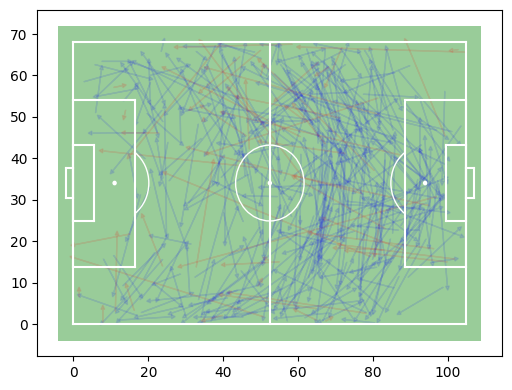

----------------------------------------------
home
England


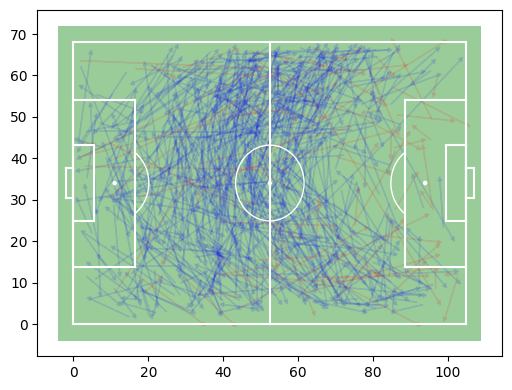

away
Iran


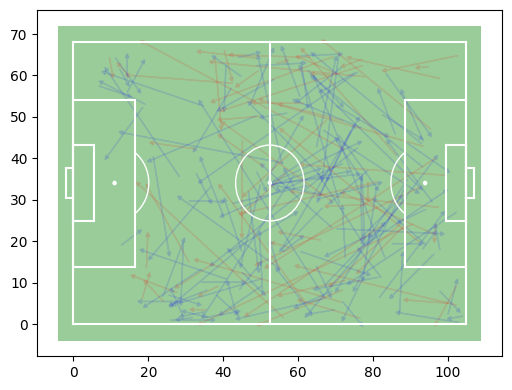

----------------------------------------------
home
Belgium


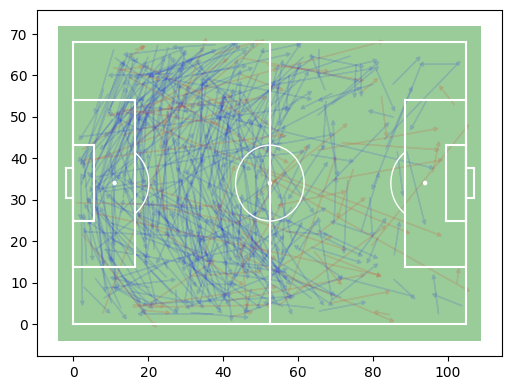

away
Canada


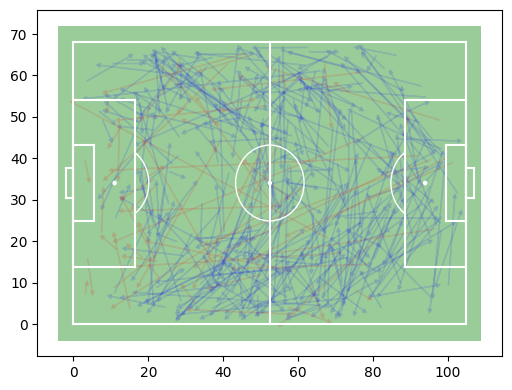

----------------------------------------------
home
Mexico


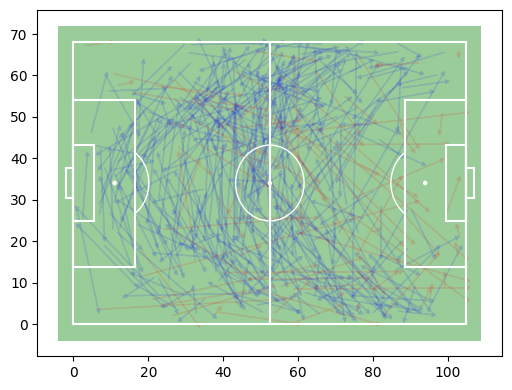

away
Poland


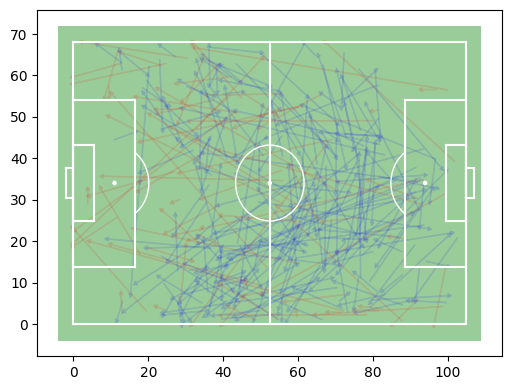

----------------------------------------------
home
South Korea


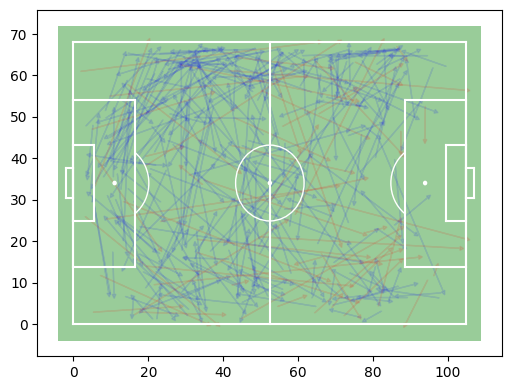

away
Portugal


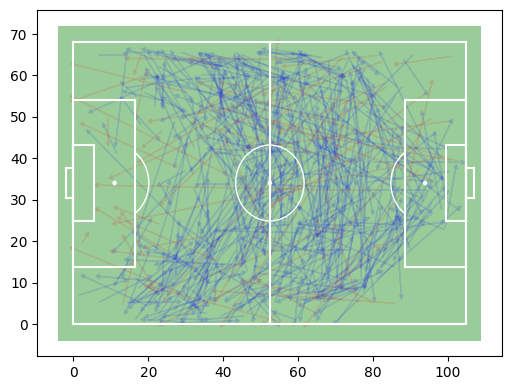

----------------------------------------------
home
Wales


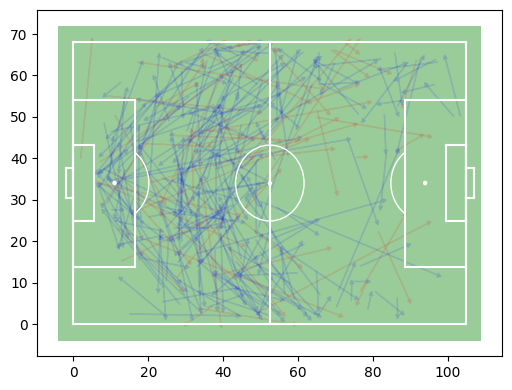

away
England


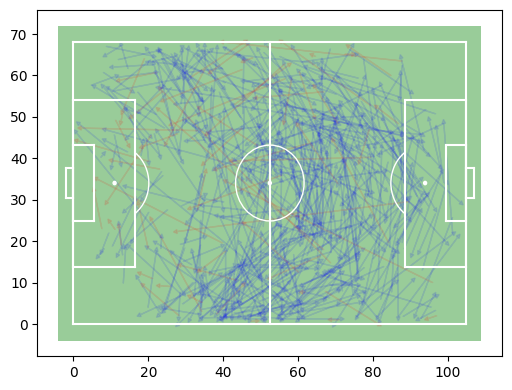

----------------------------------------------
home
Japan


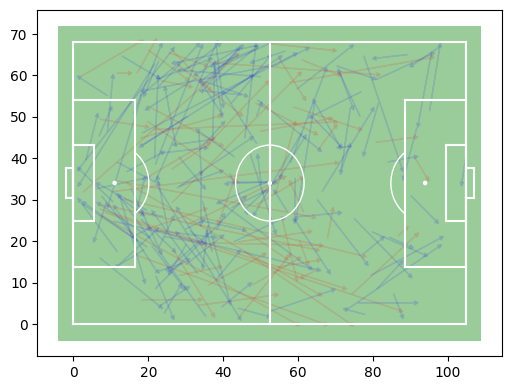

away
Spain


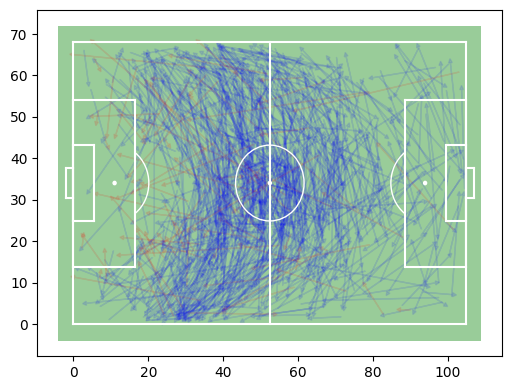

----------------------------------------------
home
Denmark


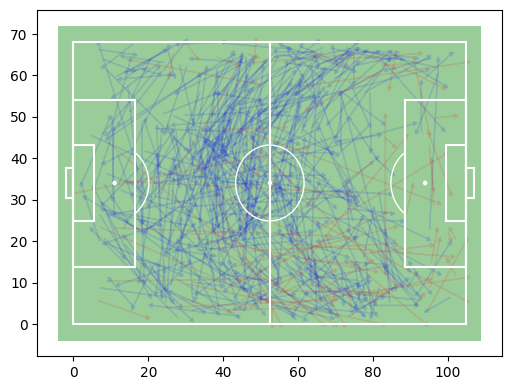

away
Tunisia


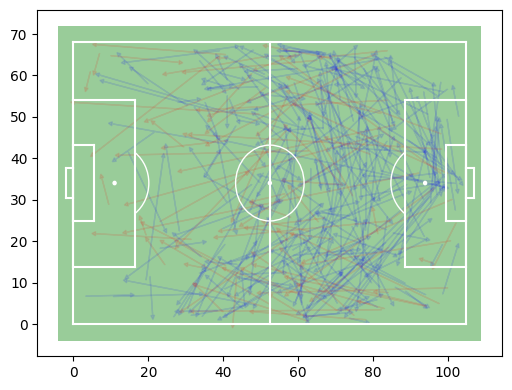

In [60]:
def drawPasses(df_passes):
    matplotsoccer.field("green",figsize=6, show=False)
    for index, item in  df_passes.iterrows():
        color='#0000FF'
        if item['result_name'] != 'success':
            color='#FF0000'
        plt.arrow(
            item['start_x'], 
            item['start_y'], 
            item['end_x'] - item['start_x'], 
            item['end_y'] - item['start_y'], 
            width=0.02, 
            head_width=1, 
            head_length=1,
            color=color,
            alpha=0.1
        )
    plt.axis("on")
    plt.show()

for index, game_obj in df_games.iterrows():
    game_id = game_obj.name

    df_events = SBL.events(game_id=game_id)
    df_players = SBL.players(game_id=game_id)

    df_actions = spadl.statsbomb.convert_to_actions(df_events, home_team_id=game_obj['home_team_id'])

    df_actions = (
      spadl
      .add_names(df_actions)  # add actiontype and result names
      .merge(SBL.teams(game_id=game_id), how='left')  # add team names
      .merge(SBL.players(game_id=game_id), how='left')  # add player names
    )
    
    df_passes = df_actions[(df_actions['type_name'] == 'pass')]
    df_home_passes = df_passes[df_passes['team_id'] == game_obj['home_team_id']]
    df_away_passes = df_passes[df_passes['team_id'] == game_obj['away_team_id']]
    
    print('----------------------------------------------')
    print('home')
    print(team_dic[game_obj['home_team_id']])
    drawPasses(df_home_passes)
    print('away')
    print(team_dic[game_obj['away_team_id']])
    drawPasses(df_away_passes)

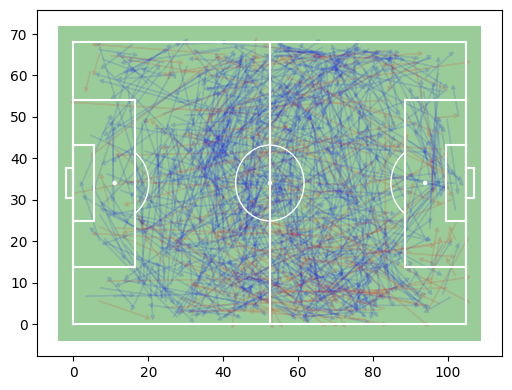

In [56]:
# temp
# 描画確認用
# drawPasses(df_actions[(df_actions['type_name'] == 'pass')])